In [ ]:
import pandas as pd
import numpy as np 
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline  
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import plot_confusion_matrix,classification_report
from sklearn.metrics import plot_precision_recall_curve
from sklearn.metrics import f1_score, accuracy_score, matthews_corrcoef
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [ ]:
data = pd.read_csv("train.csv")
data

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Cloud Cover,Pressure (millibars),Daily Summary
0,2006-04-01 00:00:00.000 +0200,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251,15.8263,0,1015.13,Partly cloudy throughout the day.
1,2006-04-01 01:00:00.000 +0200,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259,15.8263,0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 02:00:00.000 +0200,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204,14.9569,0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 03:00:00.000 +0200,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269,15.8263,0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 04:00:00.000 +0200,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259,15.8263,0,1016.51,Partly cloudy throughout the day.
...,...,...,...,...,...,...,...,...,...,...,...,...
94263,2016-05-09 19:00:00.000 +0200,Partly Cloudy,rain,19.972222,19.972222,0.40,9.4668,42,16.1000,0,1018.11,Partly cloudy throughout the day.
94264,2016-05-09 20:00:00.000 +0200,Partly Cloudy,rain,17.816667,17.816667,0.46,3.8962,19,15.5526,0,1018.42,Partly cloudy throughout the day.
94265,2016-05-09 21:00:00.000 +0200,Partly Cloudy,rain,13.938889,13.938889,0.67,8.0500,70,16.1000,0,1019.21,Partly cloudy throughout the day.
94266,2016-05-09 22:00:00.000 +0200,Partly Cloudy,rain,12.733333,12.733333,0.77,8.0500,80,16.1000,0,1019.70,Partly cloudy throughout the day.


## Data Pre-Processing :

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94268 entries, 0 to 94267
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Formatted Date            94268 non-null  object 
 1   Summary                   94268 non-null  object 
 2   Precip Type               94125 non-null  object 
 3   Temperature (C)           94268 non-null  float64
 4   Apparent Temperature (C)  94268 non-null  float64
 5   Humidity                  94268 non-null  float64
 6   Wind Speed (km/h)         94268 non-null  float64
 7   Wind Bearing (degrees)    94268 non-null  int64  
 8   Visibility (km)           94268 non-null  float64
 9   Cloud Cover               94268 non-null  int64  
 10  Pressure (millibars)      94268 non-null  float64
 11  Daily Summary             94268 non-null  object 
dtypes: float64(6), int64(2), object(4)
memory usage: 8.6+ MB


In [ ]:
data.shape

(94268, 12)

In [ ]:
data.isnull().sum()

Formatted Date                0
Summary                       0
Precip Type                 143
Temperature (C)               0
Apparent Temperature (C)      0
Humidity                      0
Wind Speed (km/h)             0
Wind Bearing (degrees)        0
Visibility (km)               0
Cloud Cover                   0
Pressure (millibars)          0
Daily Summary                 0
dtype: int64

In [ ]:
# as 143 values have Null values for Column 'Precip Type' we can drop those row it as we our dataset shape is  (94268, 12)
data = data.dropna(how ='any', axis=0)

In [ ]:
data.isnull().sum()

Formatted Date              0
Summary                     0
Precip Type                 0
Temperature (C)             0
Apparent Temperature (C)    0
Humidity                    0
Wind Speed (km/h)           0
Wind Bearing (degrees)      0
Visibility (km)             0
Cloud Cover                 0
Pressure (millibars)        0
Daily Summary               0
dtype: int64

In [ ]:
data.shape

(94125, 12)

In [ ]:
data.nunique()

Formatted Date              94101
Summary                        26
Precip Type                     2
Temperature (C)              7564
Apparent Temperature (C)     8981
Humidity                       90
Wind Speed (km/h)            2484
Wind Bearing (degrees)        360
Visibility (km)               935
Cloud Cover                     1
Pressure (millibars)         4971
Daily Summary                 207
dtype: int64

In [ ]:
data['Cloud Cover'].unique()

array([0])

In [ ]:
data['Precip Type'].unique()

array(['rain', 'snow'], dtype=object)

In [ ]:
data['Precip Type'].mode()

0    rain
dtype: object

In [ ]:
data.dtypes

Formatted Date               object
Summary                      object
Precip Type                  object
Temperature (C)             float64
Apparent Temperature (C)    float64
Humidity                    float64
Wind Speed (km/h)           float64
Wind Bearing (degrees)        int64
Visibility (km)             float64
Cloud Cover                   int64
Pressure (millibars)        float64
Daily Summary                object
dtype: object

In [ ]:
import datetime

import warnings 
warnings.filterwarnings('ignore')

In [ ]:

#changing Formatted Date datatype from object -----> to Date Time
data["Formatted Date"]= pd.to_datetime(data["Formatted Date"], utc=True)

In [ ]:
data.dtypes

Formatted Date              datetime64[ns, UTC]
Summary                                  object
Precip Type                              object
Temperature (C)                         float64
Apparent Temperature (C)                float64
Humidity                                float64
Wind Speed (km/h)                       float64
Wind Bearing (degrees)                    int64
Visibility (km)                         float64
Cloud Cover                               int64
Pressure (millibars)                    float64
Daily Summary                            object
dtype: object

In [ ]:
data.head(5)

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Cloud Cover,Pressure (millibars),Daily Summary
0,2006-03-31 22:00:00+00:00,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251,15.8263,0,1015.13,Partly cloudy throughout the day.
1,2006-03-31 23:00:00+00:00,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259,15.8263,0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 00:00:00+00:00,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204,14.9569,0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 01:00:00+00:00,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269,15.8263,0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 02:00:00+00:00,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259,15.8263,0,1016.51,Partly cloudy throughout the day.


In [ ]:
data.describe()

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Cloud Cover,Pressure (millibars)
count,94125.000000,94125.000000,94125.000000,94125.000000,94125.000000,94125.000000,94125.0,94125.000000
mean,11.946008,10.867672,0.733967,10.836279,187.690008,10.353449,0.0,1002.856814
std,9.606380,10.758266,0.196029,6.952119,107.614632,4.173782,0.0,118.379401
min,-21.822222,-27.716667,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,4.505556,2.233333,0.600000,5.796000,115.000000,8.372000,0.0,1011.800000
50%,12.066667,12.066667,0.780000,9.998100,180.000000,10.046400,0.0,1016.330000
75%,18.866667,18.866667,0.890000,14.151900,290.000000,14.812000,0.0,1021.100000
max,39.905556,39.344444,1.000000,63.852600,359.000000,16.100000,0.0,1046.380000


In [ ]:
#dropping  cloud cover column
data = data.drop('Cloud Cover', axis=1)

In [ ]:
data.head(4)

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars),Daily Summary
0,2006-03-31 22:00:00+00:00,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251,15.8263,1015.13,Partly cloudy throughout the day.
1,2006-03-31 23:00:00+00:00,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259,15.8263,1015.63,Partly cloudy throughout the day.
2,2006-04-01 00:00:00+00:00,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204,14.9569,1015.94,Partly cloudy throughout the day.
3,2006-04-01 01:00:00+00:00,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269,15.8263,1016.41,Partly cloudy throughout the day.


In [ ]:
data_unindexed = data

In [ ]:
data_unindexed.head(3)

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars),Daily Summary
0,2006-03-31 22:00:00+00:00,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251,15.8263,1015.13,Partly cloudy throughout the day.
1,2006-03-31 23:00:00+00:00,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259,15.8263,1015.63,Partly cloudy throughout the day.
2,2006-04-01 00:00:00+00:00,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204,14.9569,1015.94,Partly cloudy throughout the day.


In [ ]:
# we will set Date as the index for our dataset
# Dataframe index set to 'Formatted Date'
data = data.set_index('Formatted Date')
data.head(4)


,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars),Daily Summary
Formatted Date,,,,,,,,,,
2006-03-31 22:00:00+00:00,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251,15.8263,1015.13,Partly cloudy throughout the day.
2006-03-31 23:00:00+00:00,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259,15.8263,1015.63,Partly cloudy throughout the day.
2006-04-01 00:00:00+00:00,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204,14.9569,1015.94,Partly cloudy throughout the day.
2006-04-01 01:00:00+00:00,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269,15.8263,1016.41,Partly cloudy throughout the day.


## Exploratory Data Analysis :

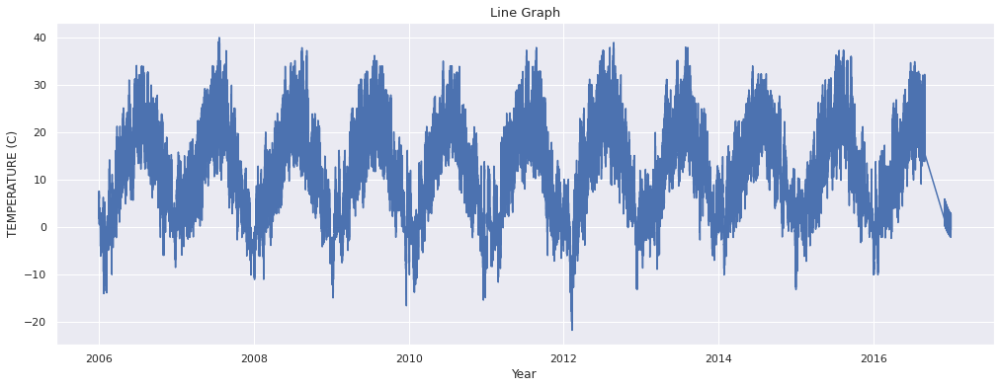

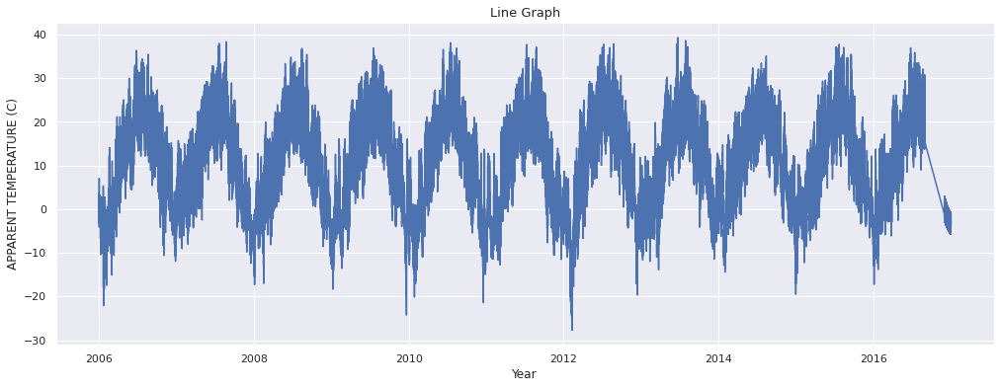

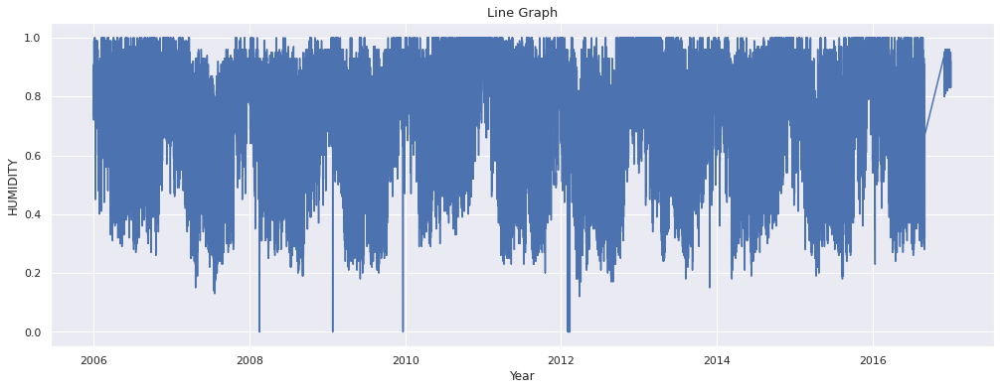

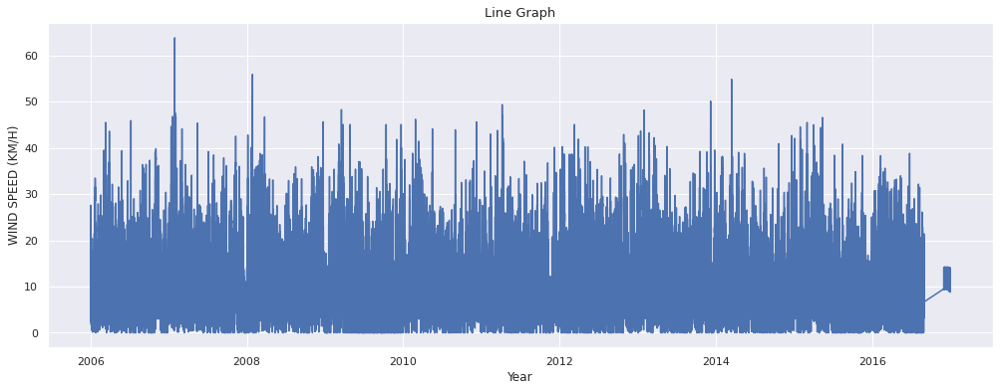

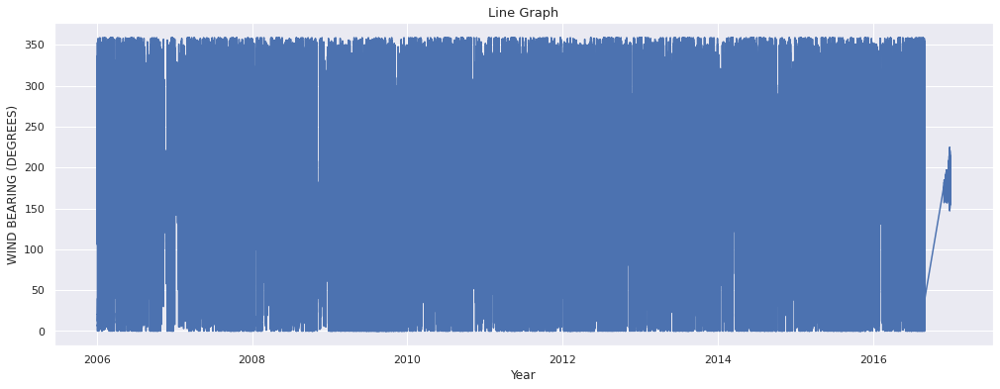

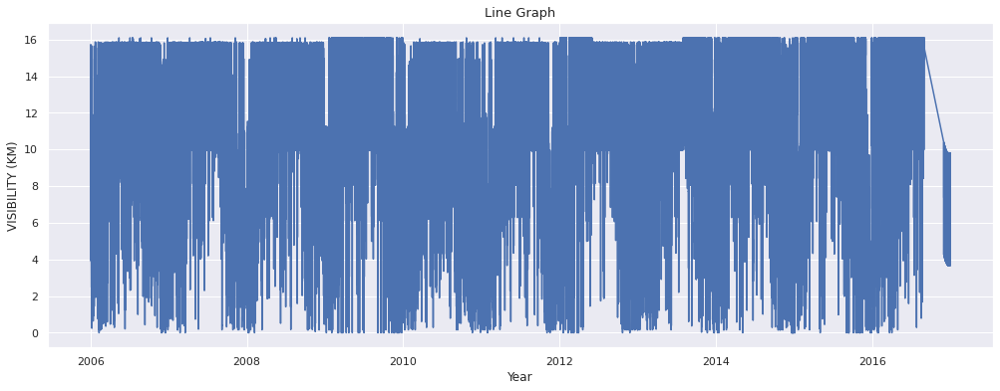

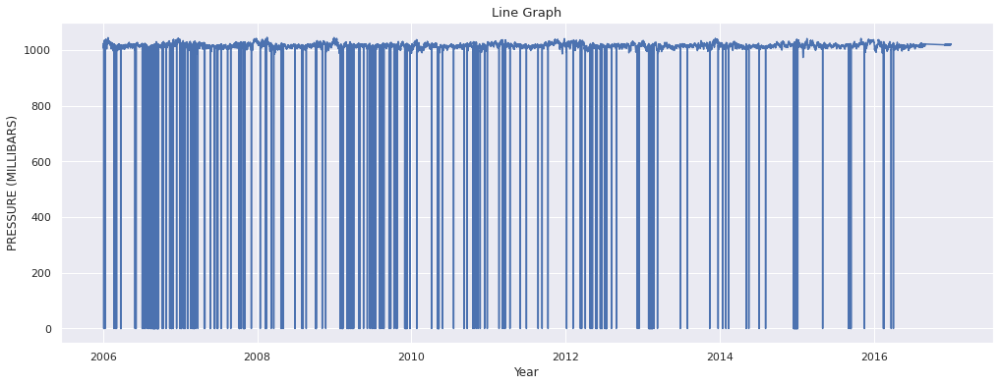

In [ ]:
for i in range(2,9):
    plt.figure(figsize=(17,6))
    plt.xlabel('Year', fontsize=12)
    plt.ylabel(data.columns[i].upper(), fontsize=12)
    plt.title('Line Graph', fontsize=13)
    sns.lineplot(data=data.iloc[:,i], )
    plt.show()

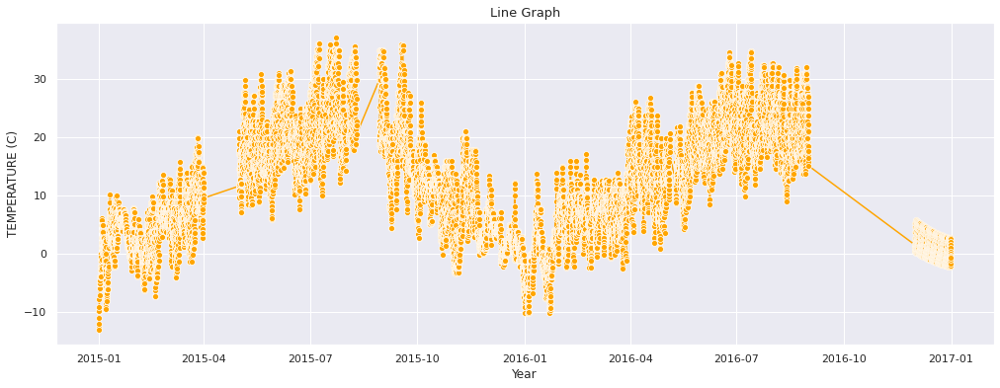

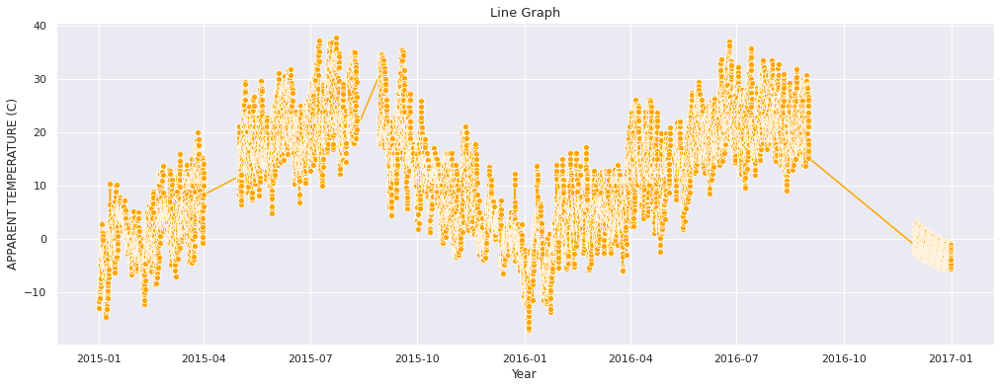

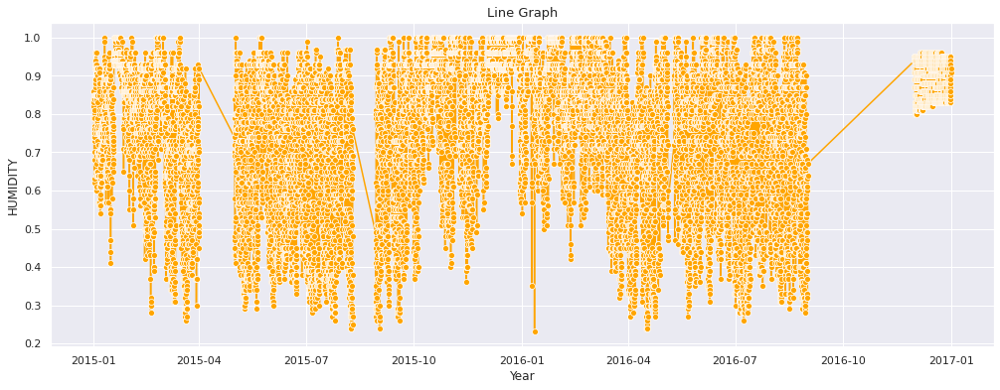

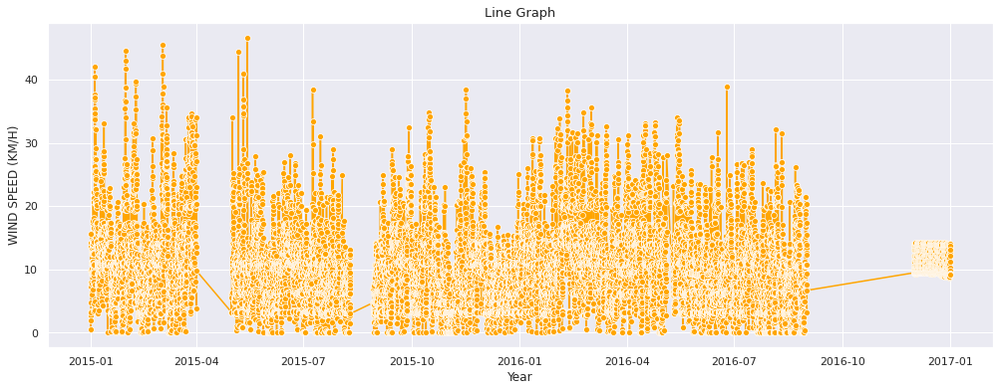

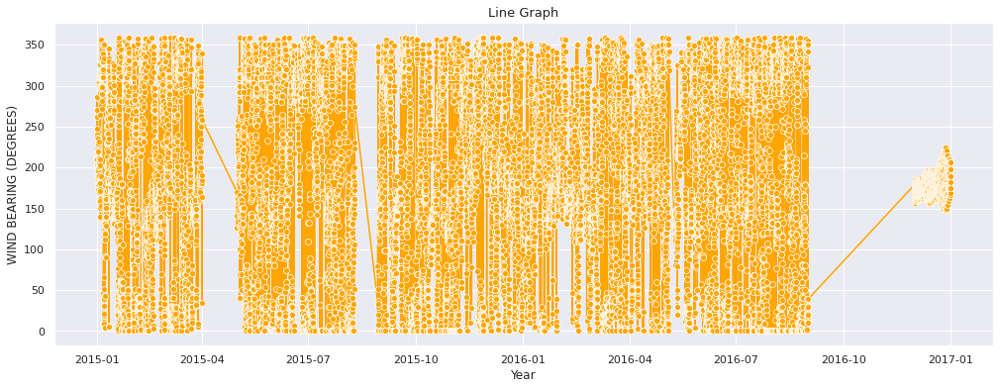

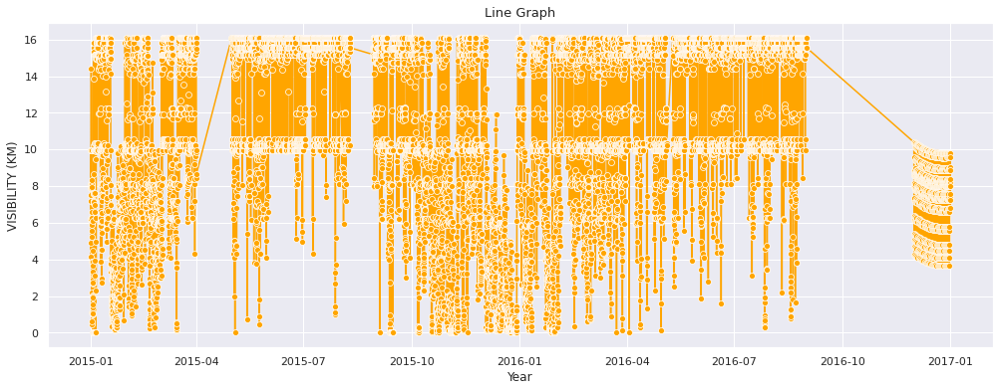

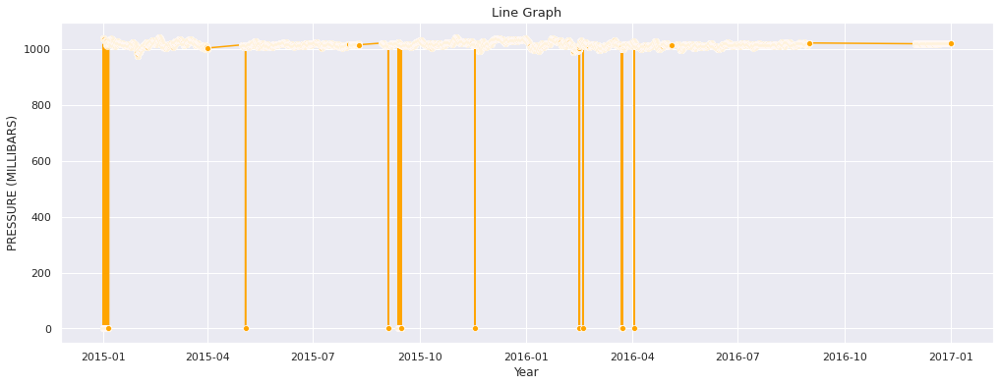

In [ ]:
# As the graph is to cluttered due to large amount of data Let's plot graph smaller range of year.
for i in range(2,9):
    plt.figure(figsize=(17,6))
    plt.xlabel('Year', fontsize=12)
    plt.ylabel(data.columns[i].upper(), fontsize=12)
    plt.title('Line Graph', fontsize=13)
    sns.lineplot(data=data.iloc[80000:94000,i],color = "Orange", marker='o' )
    plt.show()


In [ ]:
# or we can use Plotly 
import plotly.express as px
for i in range(3,10):
    fig= px.line(data_unindexed,x="Formatted Date", y=data_unindexed.iloc[:,i],title=data_unindexed.columns[i].upper())
    fig.update_xaxes(rangeslider_visible = True)

    fig.show()

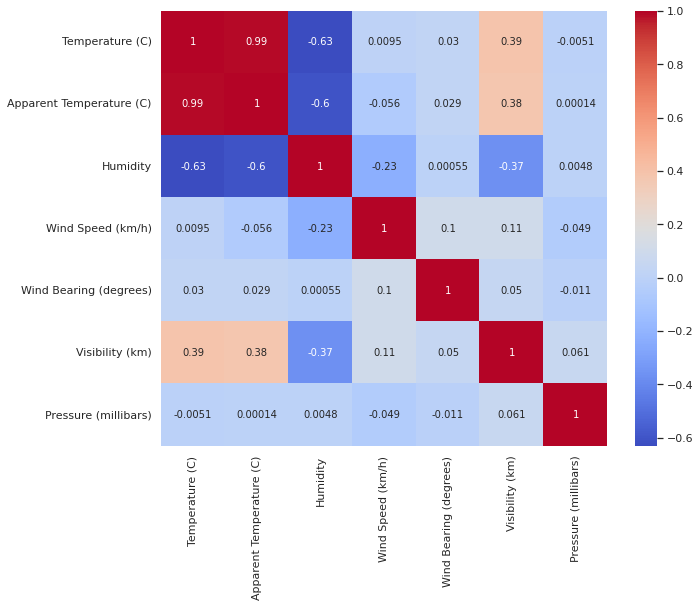

In [ ]:
#heatMap
plt.figure(figsize=(10,8))
sns.heatmap(data=data.corr(), annot=True, cmap='coolwarm')
plt.show()

In [ ]:
attributes = ['Apparent Temperature (C)', 'Humidity','Precip Type', 'Summary']
visl_data = data.loc[:,attributes]
visl_data.head()

,Apparent Temperature (C),Humidity,Precip Type,Summary
Formatted Date,,,,
2006-03-31 22:00:00+00:00,7.388889,0.89,rain,Partly Cloudy
2006-03-31 23:00:00+00:00,7.227778,0.86,rain,Partly Cloudy
2006-04-01 00:00:00+00:00,9.377778,0.89,rain,Mostly Cloudy
2006-04-01 01:00:00+00:00,5.944444,0.83,rain,Partly Cloudy
2006-04-01 02:00:00+00:00,6.977778,0.83,rain,Mostly Cloudy


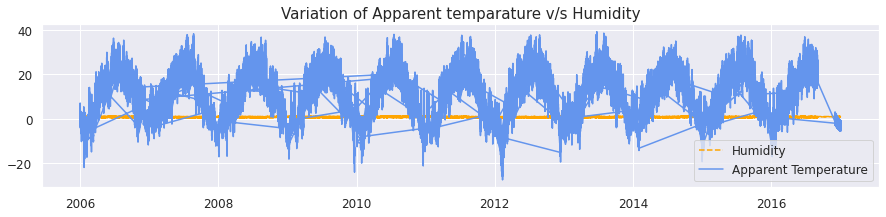

In [ ]:
# temprature vs humidity
plt.figure(figsize=(15,3));
plt.plot(visl_data['Humidity'], label = 'Humidity', color = 'orange',linestyle='dashed');
plt.plot(visl_data['Apparent Temperature (C)'], label = 'Apparent Temperature',color = 'cornflowerblue');
plt.title('Variation of Apparent temparature v/s Humidity', fontsize= 15);
plt.legend(loc = 0, fontsize = 12);
plt.xticks(fontsize = 12);
plt.yticks(fontsize = 12);

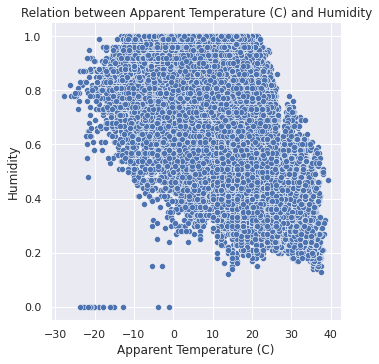

In [ ]:
sns.set(style = "darkgrid")
sns.relplot(x = "Apparent Temperature (C)" , y ="Humidity",palette="viridis", data = data);
plt.title("Relation between Apparent Temperature (C) and Humidity")
plt.show()

ValueError: ignored

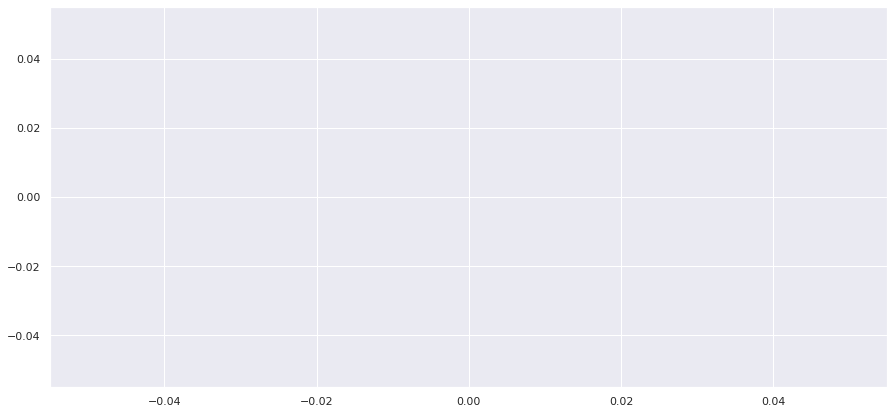

In [ ]:
plt.figure(figsize=(15,7))
sns.lineplot(x="Apparent Temperature (C)", y="Humidity", data= visl_data)

In [ ]:
sns.set_style("darkgrid")
plt.figure(figsize=(10,8))
plt.title("Correlation between Apparent temperature & Humidity")
sns.heatmap(data= visl_data.corr(), annot=True)
plt.show()

In [ ]:
#  temprature vs humidity : Summary
plt.figure(figsize=(12,12))
plt.title('Apparent Temperature vs Humidity')
sns.scatterplot(x=visl_data.iloc[:,0], y=visl_data.iloc[:,1], hue=visl_data.iloc[:,3], s=55, alpha=0.2)
plt.show()

In [ ]:
#  temprature vs humidity : Precip Type
plt.figure(figsize=(12,6))

plt.title('Apparent Temperature vs Humidity')
sns.scatterplot(x=visl_data.iloc[:,0], y=visl_data.iloc[:,1], hue=visl_data.iloc[:,2], s=50, alpha=0.2)
plt.show()

In [ ]:
sns.pairplot(visl_data, kind = 'scatter')
plt.show()

Year wise analysis:

In [ ]:
attribute = [2,4,6,7,8]
year_data = data.iloc[:, attribute].resample('Y').mean()
year_data.head(2)

In [ ]:
for i in range(len(year_data.columns)):
    sns.distplot(year_data.iloc[:, i])
    plt.show()

In [ ]:
plt.title('Heatmap', fontsize=12)
sns.heatmap(data=year_data.corr(), annot=True)
plt.show()

In [ ]:
# Pair plot for correlation
sns.pairplot(year_data, kind='reg')
plt.show()

## Year Wise Analysis:

In [ ]:
# Normalizing year data
norm_data = (year_data - year_data.min()) / (year_data.max() - year_data.min())
norm_data.head(3)

In [ ]:
# Line graph representation of all the data
plt.figure(figsize=(12,6))
plt.xlabel('YEAR')
plt.title('LINE PLOT', fontsize=25)
sns.lineplot(data=norm_data, marker='s')
plt.show()

In [ ]:
# Boxplot 
plt.figure(figsize=(10,4))
plt.title('BOX PLOT', fontsize=25)
sns.boxplot(data=norm_data)
plt.show()

In [ ]:
# Violin Plot 
plt.figure(figsize=(10,4))
plt.title('VIOLIN PLOT', fontsize=25)
sns.violinplot(data=norm_data)
plt.show()

In [ ]:
# Heatmap
plt.figure(figsize=(8,10))
plt.title('HEATMAP', fontsize=15)
sns.heatmap(norm_data, annot=True,yticklabels=norm_data.index.year)
plt.show()

## Month Wise analysis:

In [ ]:
monthly_data = data.iloc[:,3:5].resample('M').mean()
monthly_data.head(3)

In [ ]:
# Apparent Temperature Vs Humidity
plt.figure(figsize=(14,5))
plt.title('Apparent Temperature vs Humidity')
sns.lineplot(x=monthly_data.iloc[:,0], y=monthly_data.iloc[:,1])
plt.show()

In [ ]:
# Distplot :Apparent Temperature & Humidity
sns.distplot(monthly_data['Apparent Temperature (C)'])
plt.show()
sns.distplot(monthly_data['Humidity'])
plt.show()

In [ ]:
plt.figure(figsize=(10,5))
plt.xlabel('YEAR')
plt.title('Variation of Apparent Temperature and Humidity')
sns.lineplot(data=monthly_data)
plt.show()

In [ ]:
# Pair plot for correlation
print(monthly_data.corr())
sns.pairplot(monthly_data, kind='reg')
plt.show()

In [ ]:
# Plotting Humidity & Apparent Temperature for all month
TEMP_DATA = monthly_data.iloc[:,0]
HUM_DATA = monthly_data.iloc[:,1]
def label_color(month):
    if month == 1:
        return 'January','blue'
    elif month == 2:
        return 'February','green'
    elif month == 3:
        return 'March','orange'
    elif month == 4:
        return 'April','yellow'
    elif month == 5:
        return 'May','red'
    elif month == 6:
        return 'June','violet'
    elif month == 7:
        return 'July','purple'
    elif month == 8:
        return 'August','black'
    elif month == 9:
        return 'September','brown'
    elif month == 10:
        return 'October','darkblue'
    elif month == 11:
        return 'November','grey'
    else:
        return 'December','pink'

def plot_month(month, data):
    label, color = label_color(month)
    mdata = data[data.index.month == month]
    sns.lineplot(data=mdata,
                 label=label,
                 color=color,
                 marker='o')
    
def sns_plot(title, data):
    plt.figure(figsize=(14,8))
    plt.title(title)
    plt.xlabel('YEAR')
    for i in range(1,13):
        plot_month(i,data)
    plt.show()

In [ ]:
title = 'Plot of Apparent Temperature - Month-wise' 
sns_plot(title, TEMP_DATA)

In [ ]:
# Month-wise Plot for Humidity for 2006-2016 
title = 'Plot of Humidity - Month-wise' 
sns_plot(title, HUM_DATA)